In [ ]:
!pip install seaborn
!pip install Unidecode
!pip install pycountry
!pip install geonamescache
!pip install cleanco
!pip install textdistance
!pip install fuzzywuzzy
!pip install -U sentence-transformers

In [168]:
import tensorflow as tf
import tensorflow_hub as hub

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

import numpy as np
import pandas as pd

from scipy.spatial.distance import cosine

from sklearn.metrics import precision_recall_curve
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score, StratifiedKFold

from google.colab import drive
from tqdm import tqdm

import re
import string
from unidecode import unidecode
import pycountry
import geonamescache
import cleanco
import textdistance
from fuzzywuzzy import fuzz

from sentence_transformers import SentenceTransformer

import pickle

In [ ]:
pd.set_option('max_colwidth', 150)
tqdm.pandas()
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
%cd gdrive/MyDrive/itmo/

[Errno 2] No such file or directory: 'gdrive/MyDrive/itmo/'
/content/gdrive/MyDrive/itmo


In [ ]:
SEED = 2022
USE_URL = "https://tfhub.dev/google/universal-sentence-encoder/4"

### Utils

In [ ]:
def measure_similarity(vector_1, vector_2):
  return 1 - cosine(vector_1, vector_2)

In [ ]:
def plot_similarity(labels, features, rotation):
  corr = np.inner(features, features)
  sns.set(font_scale=1.2)
  g = sns.heatmap(
      corr,
      xticklabels=labels,
      yticklabels=labels,
      vmin=0,
      vmax=1,
      cmap="YlOrRd")
  g.set_xticklabels(labels, rotation=rotation)
  g.set_title("Embeddings similarity")

In [ ]:
def plot_pr_curve(duplicate_score, similarity):
    precision, recall, thresholds = precision_recall_curve(duplicate_score, similarity)
    df = pd.DataFrame({'recall': recall[:-1], 'precision': precision[:-1], 'threshold': thresholds})
    fig = px.area(
        df,
        x='recall', y='precision', 
        labels=dict(x='Recall', y='Precision'),
        hover_data=["recall", "precision", 'threshold'],
        width=1000, height=600
    )
    fig.add_shape(
        type='line', line=dict(dash='dash'),
        x0=0, x1=1, y0=1, y1=0
    )
    fig.update_yaxes(scaleanchor="x", scaleratio=1)
    fig.update_xaxes(constrain='domain')

    fig.show()

### Data preparation


In [ ]:
data = pd.read_csv('train.csv')
data.head()

,pair_id,name_1,name_2,is_duplicate
0,1,Iko Industries Ltd.,"Enormous Industrial Trade Pvt., Ltd.",0
1,2,Apcotex Industries Ltd.,Technocraft Industries (India) Ltd.,0
2,3,"Rishichem Distributors Pvt., Ltd.",Dsa,0
3,4,Powermax Rubber Factory,Co. One,0
4,5,Tress A/S,Longyou Industries Park Zhejiang,0


In [ ]:
data[data['is_duplicate'] == 1].head()

,pair_id,name_1,name_2,is_duplicate
161,162,JX Nippon Oil & Gas Exploration (Brasil) Ltda,JX Nippon Oil & Gas Exploration Technical Services Corporation,1
603,604,Pirelli Neumaticos S.A.I.C.,"Pirelli Tyre Co., Ltd.",1
835,836,Brenntag Australia (Pty) Ltd.,Brenntag Group,1
1328,1329,"PAUL BAUDER GMBH & CO KG, BOCHUM PLANT",Paul Bauder ag,1
1562,1563,TOTAL CESKA REPUBLIKA s.r.o.,TOTAL FRANCE (ARNAY LE DUC),1


In [ ]:
data['is_duplicate'].value_counts()

0    494161
1      3658
Name: is_duplicate, dtype: int64

In [ ]:
data = data.drop_duplicates()

#### Base preprocessing

In [ ]:
base_stopwords = [*string.ascii_letters]
geo_names = geonamescache.GeonamesCache()

In [ ]:
with open('legal_entities.txt') as f:
  legal_entities = f.read().split()
  legal_entities = [re.sub(f"[{string.punctuation}]+", ' ', entity) for entity in legal_entities]
  legal_entities = [unidecode(entity) for entity in legal_entities]
  legal_entities = [re.sub(' +', ' ', entity) for entity in legal_entities]
legal_entities[:10]

['iks ',
 'sociedad',
 'en',
 'comandita',
 'simple ',
 'ops ',
 'partnership ',
 'kapitalgesellschaften ',
 'dio',
 'stranog']

In [ ]:
def rm_company_suffix(text):
  return cleanco.basename(text)

In [ ]:
def get_usa_states():
  return [item['name'].lower() for item in geo_names.get_us_states().values()]

def get_cities():
  return [item['name'].lower() for item in geo_names.get_cities().values()]     

In [ ]:
countries = [country.name.lower() for country in list(pycountry.countries)]
additional_world_parts = ['usa', 'us', 'americas', 'america', 'north', 'west', 'east', 'south', 'brasil', 'mexico', 'eu', 'europe', 'area', 'city', 'asia']
chinese_data = pd.read_csv('cn.csv')
chinese_provincial_names = chinese_data['admin_name'].str.lower().unique()
chinese_cities = chinese_data['city'].str.lower().unique()
all_cities = list(set(get_cities()).union(set(chinese_cities.tolist())))
usa_state = get_usa_states()
all = countries + additional_world_parts + chinese_provincial_names.tolist() + all_cities + usa_state
print(len(all))

def rm_toponyms(text):
  text = ' '.join([item for item in text.split() if item not in all])
  return text

26337


In [ ]:
def preprocess(text):
    text = unidecode(text)
    text = text.lower()
    text = re.sub(f"[{string.punctuation}]+", ' ', text)
    text = re.sub(r'(?<=\b\w)\s*(?=\w\b)', '', text)
    text = re.sub(f"[{string.digits}]+", ' ', text)
    text = re.sub(r"\(.*\)", '', text)
    text = re.sub(' +', ' ', text)
    text = rm_company_suffix(text)
    text = rm_toponyms(text)
    text = ' '.join([item for item in text.split() if item not in base_stopwords])
    text = ' '.join([item for item in text.split() if item not in legal_entities])
    return text

In [ ]:
data['name_1'] = data['name_1'].progress_apply(lambda x: preprocess(x))
data['name_2'] = data['name_2'].progress_apply(lambda x: preprocess(x))
data.head()

100%|██████████| 497819/497819 [12:59<00:00, 638.99it/s]


,pair_id,name_1,name_2,is_duplicate
0,1,iko industries,enormous trade,0
1,2,apcotex industries,technocraft industries,0
2,3,rishichem distributors,dsa,0
3,4,powermax rubber factory,one,0
4,5,tress,longyou industries park,0


#### Construct additional stopwords

In [ ]:
from collections import Counter
counter_names = Counter(
    ' '.join(data['name_1'].values.tolist()).split(' ') + 
    ' '.join(data['name_2'].values.tolist()).split(' ')
)
print([item[0] for item in counter_names.most_common(200)])

['international', 'industries', 'logistics', 'rubber', 'sa', 'products', 'imp', '', 'exp', 'chemical', 'plastic', 'enterprises', 'chemicals', 'industria', 'group', 'sports', 'trade', 'global', 'plastics', 'rl', 'al', 'ltd', 'comercio', 'technology', 'polymers', 'services', 'textile', 'industry', 'intl', 'sr', 'materials', 'logistica', 'bank', 'technologies', 'industrias', 'do', 'mfg', 'ds', 've', 'solutions', 'engineering', 'ram', 'inc', 'automotive', 'service', 'auto', 'sk', 'electronics', 'itc', 'shoes', 'soprema', 'spinning', 'as', 'industriales', 'mills', 'cargo', 'freight', 'llc', 'ri', 'tech', 'new', 'ta', 'equipment', 'polymer', 'ticaret', 'systems', 'transportes', 'sac', 'bridgestone', 'sanayi', 'synthetic', 'transport', 'corporation', 'american', 'sport', 'material', 'ib', 'precision', 'corp', 'distribution', 'supply', 'total', 'one', 'united', 'shipping', 'com', 'ace', 'to', 'parts', 'world', 'rubbers', 'express', 'logistic', 'comercial', 'electronic', 'eia', 'basf', 'nad', '

In [150]:
stopwords = ['international', 'de', 'industries', 'trading', 'logistics', 'products', 'industrial', 'exp', '',  'and', 'enterprises', 'co', 'industria', 'usa', 'trade', 'group', 'us',
'global', 'comercio', 'america', 'technology', 'ltd', 'services', 'general', 'brasil', 'al', 'industry', 'of', 'the', 'agency', 'pc', 'assn', 'assoc', 'brands', 'brand', 'corp',
'logistica', 'pt', 'bank', 'technologies', 'enterprise', 'industrias', 'solutions', 'engineering', 'service', 'city', 'plc', 'associates', 'incorporated', 'americas', 'arnay le duc',
'electronics', 'inc', 'spinning', 'sociedad', 'industriales', 'mills', 'north', 'cargo', 'freight', 'tech', 'llc', 'equipment', 'ticaret', 'ceska', 'republika', 'ooo', 'ооо',
'systems', 'transportes', 'new', 'sanayi', 'asia', 'transport', 'american', 'precision', 'distribution', 'us', 'supply', 'total', 'bv', 'comp', 'lp', 'comenrcio',  'rumunia', 'commerce', 
 'united', 'to', 'parts', 'world', 'com', 'express', 'logistic', 'comercial', 'for', 'electronic', 'manufacturing', 'sarawak', 'technical', 'kg', 'de', 'mexicosa', 'salgareda', 'do',
 'gmb', 'worldwide',  'hardware', 'chem', 'development', 'tyre', 'star', 'marketing', 'internacionais', 'svcs', 'llp', 'company', 'plant', 'eu', 'all', 'monterreysa', 'europe', 'id', 'grobbendonk',
 'national', 'product', 'traders', 'pacific', 'air', 'ltda', 'forwarding', 'productos', 'energy', 'construction', 'unlimited', 'intl', 'tse', 'imp', 'venezuela', 'industriali', 'vietnam', 'brasil',
 'management', 'in', 'order', 'sales', 'quimica', 'europe',  'trans',  'zone', 'lg', 'importacao', 'grupp', 'roppongi', 'co', 'thai', 'deutschland', 'drummondville', 'stargard', 'espana', 'nederland', 'costa',
 'overseas', 'performance', 'exportacao', 'polska', 'east',   'metal', 'free', 'factory', 'corporation', 'gmbh', 'light', 'chain', 'continental', 'holdings', 'holding', 'industriesusa',
 'chemicals', 'plactic', 'rubber', 'elastomer', 'chemical', 'tire', 'retail', 'gestion', 'thermoplastic', 'compounds', 'polymers', 'plants', 'neumaticos', 'ingredients', 'alpiarca', 'oil', 'automotive',
 'development', 'research', 'center', 'plastiche', 'transportbandsysteme', 'products', 'pneus', 'tyres', 'antriebssysteme', 'elastomers', 'clothing', 'fashion', 'polimeros', 'mobile',
 ]

In [ ]:
def rm_stopwords(text):
  return ' '.join([item for item in text.split() if item not in stopwords])

In [151]:
data['name_1'] = data['name_1'].progress_apply(lambda x: rm_stopwords(x))
data['name_2'] = data['name_2'].progress_apply(lambda x: rm_stopwords(x))
data[data['is_duplicate'] == 1].head(20)

100%|██████████| 435098/435098 [00:02<00:00, 168714.90it/s]


,pair_id,name_1,name_2,is_duplicate,is_full_duplicate,similarity_paraphrase
161,162,jx nippon gas exploration,jx nippon gas exploration,1,1,1.000000
603,604,pirelli saic,pirelli,1,0,0.588114
835,836,brenntag,brenntag,1,1,1.000000
1328,1329,paul bauder,paul bauder,1,1,1.000000
1786,1787,bridgestone,bridgestone,1,1,1.000000
1798,1799,brenntag sac,brenntag,1,0,0.824698
1962,1963,coatings waterproofing,coatings wtrprfng,1,0,0.599406
2054,2055,bridgestone,bridgestone,1,1,1.000000
2772,2773,onduline,onduline,1,1,1.000000
2790,2791,rhino,rhino,1,1,1.000000


#### Remove empty strings or full duplicate 0-labeled rows

In [152]:
data['is_full_duplicate'] = data.apply(lambda x: set(x.name_1.split()) == set(x.name_2.split()), axis=1).astype('int')

In [153]:
data[(data['is_full_duplicate'] == 1) & (data['is_duplicate'] == 0)].head()

,pair_id,name_1,name_2,is_duplicate,is_full_duplicate,similarity_paraphrase


In [154]:
data = data.drop(data[(data['is_full_duplicate'] == 1) & (data['is_duplicate'] == 0)].index)

In [155]:
data = data.drop(data[(data['name_1'] == '') | (data['name_2'] == '')].index) #?

In [156]:
data['is_duplicate'].value_counts()

0    431586
1      3512
Name: is_duplicate, dtype: int64

### Tensorflow USE

In [ ]:
model = hub.load(USE_URL)

In [ ]:
def get_embeddings(sentences):
  return model(sentences)

#### Build few embeddings and visualize correlations

In [ ]:
different = data[data['is_duplicate'] == 0].head(3)[['name_1', 'name_2']]
duplicated = data[data['is_duplicate'] == 1].head(3)[['name_1', 'name_2']]
top_12 = different.values.flatten().tolist() +  duplicated.values.flatten().tolist() 

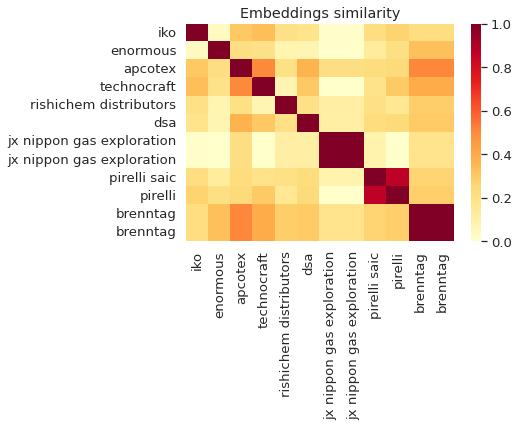

In [ ]:
message_embeddings = get_embeddings(top_12)
plot_similarity(top_12, message_embeddings, 90)

#### Let's measure similarity and compare with labels

CS (cosine similarity) = 1 - CD (cosine distance)

In [ ]:
#data = data.sample(frac=1, random_state=SEED).iloc[:100_000]

In [ ]:
%%time

embeddings_name_1 = get_embeddings(data['name_1'])
embeddings_name_2 = get_embeddings(data['name_2'])

CPU times: user 17.6 s, sys: 360 ms, total: 18 s
Wall time: 16.5 s


In [ ]:
%%time
data['similarity'] = [measure_similarity(v_1, v_2) for v_1, v_2 in zip(embeddings_name_1, embeddings_name_2)]
data.head()

CPU times: user 6min 24s, sys: 24.2 s, total: 6min 48s
Wall time: 6min 21s


,pair_id,name_1,name_2,is_duplicate,is_full_duplicate,similarity
0,1,iko,enormous,0,0,0.032878
1,2,apcotex,technocraft,0,0,0.505820
2,3,rishichem distributors,dsa,0,0,0.203053
3,4,powermax,one,0,0,0.223368
4,5,tress,longyou park,0,0,0.244124


In [ ]:
data[data['is_duplicate'] == 0].sort_values(by=['similarity']).tail(10)

,pair_id,name_1,name_2,is_duplicate,is_full_duplicate,similarity
437941,437942,sanxing mould plastic,ruqiang mould plastic,0,0,0.940849
382085,382086,weipeng plastics,guangyao plastics,0,0,0.941712
68156,68157,essers iso hessenatie,essers iso hessenatie logisti,0,0,0.941764
106705,106706,huazhi mould plastic,hengyi mould plastic,0,0,0.942834
460369,460370,hengyi mould plastic,huazhi mould plastic,0,0,0.942835
148378,148379,indo rama synthetics,indo rama synthetics tbk,0,0,0.948229
74478,74479,tata motors,tata motors distribusi,0,0,0.950243
229806,229807,rhino,rhino teamwear,0,0,0.951897
72681,72682,baker hughes,baker hughes eho,0,0,0.973824
336982,336983,baker hughes,baker hughes eho,0,0,0.973824


In [ ]:
data[data['is_duplicate'] == 1].sort_values(by=['similarity']).iloc[30:60]

,pair_id,name_1,name_2,is_duplicate,is_full_duplicate,similarity
111369,111370,synthomer peachtree lenox bl bonded statesville,synthomer,1,0,0.088408
231763,231764,synthomer peachtree lenox bl bonded statesville,synthomer,1,0,0.088408
218894,218895,synthomer,synthomer peachtree lenox bl bonded statesville,1,0,0.088408
302834,302835,synthomer peachtree lenox bl bonded statesville,synthomer,1,0,0.088408
476510,476511,synthomer,synthomer peachtree lenox bl bonded statesville,1,0,0.088408
281403,281404,epiroc drilling,epirok rus,1,0,0.090478
472292,472293,westensee partner rohstoff,awp rohstoffe,1,0,0.094635
60438,60439,kimberly clark,kimberli klark,1,0,0.094948
69550,69551,kimberly clark,kimberli klark,1,0,0.094948
391131,391132,kimberly clark,kimberli klark,1,0,0.094948


We can try to build precision-recall curve to determine the best threshold for distinguishing duplicate questions from the rest.

In [ ]:
plot_pr_curve(data['is_duplicate'], data['similarity'])

### Simple text distance metrics

#### Compute vectors

In [ ]:
distance_methods = [
    fuzz.ratio,
    fuzz.partial_ratio,
    fuzz.token_sort_ratio,
    fuzz.token_set_ratio,
    textdistance.mlipns.normalized_similarity,
    textdistance.hamming.similarity,
    textdistance.hamming.normalized_similarity,
    textdistance.levenshtein.similarity,
    textdistance.levenshtein.normalized_similarity,
    textdistance.damerau_levenshtein.normalized_similarity,
    textdistance.jaro_winkler.normalized_similarity,
    textdistance.strcmp95.normalized_similarity,
    textdistance.tanimoto.normalized_similarity,
    textdistance.monge_elkan.normalized_similarity,
    textdistance.lcsseq.normalized_similarity,
    textdistance.lcsstr.normalized_similarity,
    textdistance.needleman_wunsch.similarity,
    textdistance.needleman_wunsch.normalized_similarity,
    textdistance.gotoh.normalized_similarity,
    textdistance.smith_waterman.normalized_similarity,
    textdistance.ratcliff_obershelp.similarity,
    textdistance.cosine.similarity,
    textdistance.jaccard.similarity,
    textdistance.sorensen.similarity
]
distance_names = [
    "fuzz.ratio",
    "fuzz.partial_ratio",
    "fuzz.token_sort_ratio",
    "fuzz.token_set_ratio",
    "textdistance.mlipns.normalized_similarity",
    "textdistance.hamming.similarity",
    "textdistance.hamming.normalized_similarity",
    "textdistance.levenshtein.similarity",
    "textdistance.levenshtein.normalized_similarity",
    "textdistance.damerau_levenshtein.normalized_similarity",
    "textdistance.jaro_winkler.normalized_similarity",
    "textdistance.strcmp95.normalized_similarity",
    "textdistance.tanimoto.normalized_similarity",
    "textdistance.monge_elkan.normalized_similarity",
    "textdistance.lcsseq.normalized_similarity",
    "textdistance.lcsstr.normalized_similarity",
    "textdistance.needleman_wunsch.similarity",
    "textdistance.needleman_wunsch.normalized_similarity",
    "textdistance.gotoh.normalized_similarity",
    "textdistance.smith_waterman.normalized_similarity",
    "textdistance.ratcliff_obershelp.similarity",
    "textdistance.cosine.similarity",
    "textdistance.jaccard.similarity",
    "textdistance.sorensen.similarity"
]

In [ ]:
def get_distance_vector(text_1, text_2):
  res = []
  for method in distance_methods:
    res.append(method(text_1, text_2))
  return res

In [ ]:
%%time

distance_vectores = pd.DataFrame(data.apply(lambda x: get_distance_vector(x['name_1'], x['name_2']), axis=1).tolist())

CPU times: user 30min 21s, sys: 7.45 s, total: 30min 29s
Wall time: 30min 27s


In [ ]:
distance_vectores.columns = distance_names
distance_vectores.head()

,fuzz.ratio,fuzz.partial_ratio,fuzz.token_sort_ratio,fuzz.token_set_ratio,textdistance.mlipns.normalized_similarity,textdistance.hamming.similarity,textdistance.hamming.normalized_similarity,textdistance.levenshtein.similarity,textdistance.levenshtein.normalized_similarity,textdistance.damerau_levenshtein.normalized_similarity,...,textdistance.lcsseq.normalized_similarity,textdistance.lcsstr.normalized_similarity,textdistance.needleman_wunsch.similarity,textdistance.needleman_wunsch.normalized_similarity,textdistance.gotoh.normalized_similarity,textdistance.smith_waterman.normalized_similarity,textdistance.ratcliff_obershelp.similarity,textdistance.cosine.similarity,textdistance.jaccard.similarity,textdistance.sorensen.similarity
0,18,33,18,18,0.0,1,0.125000,1,0.125000,0.125000,...,0.125000,0.125000,-4.0,0.250000,0.233333,0.000000,0.181818,0.204124,0.100000,0.181818
1,22,29,22,22,0.0,1,0.090909,2,0.181818,0.181818,...,0.272727,0.181818,-2.0,0.409091,0.442857,0.142857,0.222222,0.569803,0.384615,0.555556
2,8,67,16,16,0.0,0,0.000000,2,0.090909,0.090909,...,0.090909,0.045455,-17.0,0.113636,-0.733333,0.000000,0.080000,0.246183,0.086957,0.160000
3,36,67,36,36,0.0,0,0.000000,2,0.250000,0.250000,...,0.250000,0.125000,-3.0,0.312500,0.300000,0.000000,0.363636,0.408248,0.222222,0.363636
4,12,25,12,12,0.0,0,0.000000,0,0.000000,0.000000,...,0.083333,0.083333,-7.0,0.208333,0.160000,0.000000,0.117647,0.129099,0.062500,0.117647


In [ ]:
data_with_distances = data.copy()
data_with_distances[distance_names] = distance_vectores.values
data_with_distances.head()

,pair_id,name_1,name_2,is_duplicate,is_full_duplicate,similarity,fuzz.ratio,fuzz.partial_ratio,fuzz.token_sort_ratio,fuzz.token_set_ratio,...,textdistance.lcsseq.normalized_similarity,textdistance.lcsstr.normalized_similarity,textdistance.needleman_wunsch.similarity,textdistance.needleman_wunsch.normalized_similarity,textdistance.gotoh.normalized_similarity,textdistance.smith_waterman.normalized_similarity,textdistance.ratcliff_obershelp.similarity,textdistance.cosine.similarity,textdistance.jaccard.similarity,textdistance.sorensen.similarity
0,1,iko,enormous,0,0,0.032878,18.0,33.0,18.0,18.0,...,0.125000,0.125000,-4.0,0.250000,0.233333,0.000000,0.181818,0.204124,0.100000,0.181818
1,2,apcotex,technocraft,0,0,0.505820,22.0,29.0,22.0,22.0,...,0.272727,0.181818,-2.0,0.409091,0.442857,0.142857,0.222222,0.569803,0.384615,0.555556
2,3,rishichem distributors,dsa,0,0,0.203053,8.0,67.0,16.0,16.0,...,0.090909,0.045455,-17.0,0.113636,-0.733333,0.000000,0.080000,0.246183,0.086957,0.160000
3,4,powermax,one,0,0,0.223368,36.0,67.0,36.0,36.0,...,0.250000,0.125000,-3.0,0.312500,0.300000,0.000000,0.363636,0.408248,0.222222,0.363636
4,5,tress,longyou park,0,0,0.244124,12.0,25.0,12.0,12.0,...,0.083333,0.083333,-7.0,0.208333,0.160000,0.000000,0.117647,0.129099,0.062500,0.117647


In [ ]:
data_with_distances.iloc[:, 5:]

,similarity,fuzz.ratio,fuzz.partial_ratio,fuzz.token_sort_ratio,fuzz.token_set_ratio,textdistance.mlipns.normalized_similarity,textdistance.hamming.similarity,textdistance.hamming.normalized_similarity,textdistance.levenshtein.similarity,textdistance.levenshtein.normalized_similarity,...,textdistance.lcsseq.normalized_similarity,textdistance.lcsstr.normalized_similarity,textdistance.needleman_wunsch.similarity,textdistance.needleman_wunsch.normalized_similarity,textdistance.gotoh.normalized_similarity,textdistance.smith_waterman.normalized_similarity,textdistance.ratcliff_obershelp.similarity,textdistance.cosine.similarity,textdistance.jaccard.similarity,textdistance.sorensen.similarity
0,0.032878,18.0,33.0,18.0,18.0,0.0,1.0,0.125000,1.0,0.125000,...,0.125000,0.125000,-4.0,0.250000,0.233333,0.000000,0.181818,0.204124,0.100000,0.181818
1,0.505820,22.0,29.0,22.0,22.0,0.0,1.0,0.090909,2.0,0.181818,...,0.272727,0.181818,-2.0,0.409091,0.442857,0.142857,0.222222,0.569803,0.384615,0.555556
2,0.203053,8.0,67.0,16.0,16.0,0.0,0.0,0.000000,2.0,0.090909,...,0.090909,0.045455,-17.0,0.113636,-0.733333,0.000000,0.080000,0.246183,0.086957,0.160000
3,0.223368,36.0,67.0,36.0,36.0,0.0,0.0,0.000000,2.0,0.250000,...,0.250000,0.125000,-3.0,0.312500,0.300000,0.000000,0.363636,0.408248,0.222222,0.363636
4,0.244124,12.0,25.0,12.0,12.0,0.0,0.0,0.000000,0.0,0.000000,...,0.083333,0.083333,-7.0,0.208333,0.160000,0.000000,0.117647,0.129099,0.062500,0.117647
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
497814,0.131351,13.0,14.0,13.0,13.0,0.0,0.0,0.000000,1.0,0.125000,...,0.125000,0.125000,0.0,0.500000,0.500000,0.142857,0.133333,0.133631,0.071429,0.133333
497815,0.021794,6.0,33.0,6.0,6.0,0.0,0.0,0.000000,1.0,0.035714,...,0.035714,0.035714,-24.0,0.071429,-1.200000,0.000000,0.064516,0.109109,0.033333,0.064516
497816,0.224732,29.0,40.0,29.0,29.0,0.0,0.0,0.000000,1.0,0.125000,...,0.250000,0.125000,-1.0,0.437500,0.416667,0.000000,0.285714,0.433013,0.272727,0.428571
497817,0.286529,10.0,18.0,10.0,10.0,0.0,1.0,0.076923,2.0,0.153846,...,0.153846,0.076923,-4.0,0.346154,0.385714,0.000000,0.100000,0.314485,0.176471,0.300000


In [ ]:
data_with_distances.replace([np.inf, -np.inf], np.nan, inplace=True)
data_with_distances = data_with_distances.dropna()

#### Cross-validation

In [ ]:
%%time

skf = StratifiedKFold(n_splits=3)
clf = RandomForestClassifier(random_state=SEED)
cross_val_score(clf, data_with_distances.iloc[:, 5:], data_with_distances['is_duplicate'], cv=skf, scoring='f1')

CPU times: user 3min 5s, sys: 395 ms, total: 3min 5s
Wall time: 3min 15s


array([0.90413294, 0.90901288, 0.90457852])

#### Training & analysis

In [ ]:
# TODO

### paraphrase-MiniLM-L6-v2

In [ ]:
s_model = SentenceTransformer('paraphrase-MiniLM-L6-v2')

Downloading:   0%|          | 0.00/690 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/190 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/3.69k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/629 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/122 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/112 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/466k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/314 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/232k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/229 [00:00<?, ?B/s]

In [157]:
%%time

embeddings_name_1 = s_model.encode(data['name_1'].values)
embeddings_name_2 = s_model.encode(data['name_2'].values)

CPU times: user 3min 15s, sys: 5.22 s, total: 3min 20s
Wall time: 3min 9s


In [158]:
%%time
data['similarity_paraphrase'] = [measure_similarity(v_1, v_2) for v_1, v_2 in zip(embeddings_name_1, embeddings_name_2)]
data.head()

CPU times: user 19.7 s, sys: 63.1 ms, total: 19.8 s
Wall time: 19.7 s


,pair_id,name_1,name_2,is_duplicate,is_full_duplicate,similarity_paraphrase
0,1,iko,enormous,0,0,0.155155
1,2,apcotex,technocraft,0,0,0.200196
2,3,rishichem distributors,dsa,0,0,0.016677
3,4,powermax,one,0,0,0.128145
4,5,tress,longyou park,0,0,0.210118


In [167]:
embeddings_all = {}
for text, embedding in zip(data['name_1'].values.tolist(), embeddings_name_1):
  embeddings_all[text] = embedding
for text, embedding in zip(data['name_2'].values.tolist(), embeddings_name_2):
  embeddings_all[text] = embedding
len(embeddings_all)

14828

In [172]:
with open('draft_embeddings_paraphrase-MiniLM-L6-v2.pkl', mode='wb') as f:
  pickle.dump(embeddings_all, f)

In [159]:
plot_pr_curve(data['is_duplicate'], data['similarity_paraphrase'])

In [160]:
data[data['is_duplicate'] == 0].sort_values(by=['similarity_paraphrase']).tail(10) # Местами, похоже, что нашли ошибки в разметке / опечатки

,pair_id,name_1,name_2,is_duplicate,is_full_duplicate,similarity_paraphrase
271810,271811,compania,companias,0,0,0.968651
248622,248623,compania,companias,0,0,0.968651
433134,433135,basic adhesives,adhesives,0,0,0.969208
388706,388707,basic adhesives,advanced adhesives,0,0,0.971817
263971,263972,fr meyers sohn,fr meyer sohn,0,0,0.974864
197055,197056,adhesive,adhesives,0,0,0.977036
436675,436676,adhesive,adhesives,0,0,0.977037
304600,304601,pervez sons,pervezs sons,0,0,0.978475
94990,94991,ess ess footwear,ess ess footwears,0,0,0.988967
60386,60387,atto abrasives rl,atto abrasivess rl,0,0,0.989930


In [162]:
data[data['is_duplicate'] == 1].sort_values(by=['similarity_paraphrase']).head(10)

,pair_id,name_1,name_2,is_duplicate,is_full_duplicate,similarity_paraphrase
114245,114246,bitumen,czech,1,0,0.005694
2815,2816,bitumen,czech,1,0,0.005694
404105,404106,agilent mfg shipping department,adzhilent teknolodzhiz,1,0,0.033564
462455,462456,bit mat,klink,1,0,0.035479
410292,410293,heavy,kavasaki gaz turbin servis rus,1,0,0.038825
439173,439174,arnay le duc,petrochemicals,1,0,0.055289
366473,366474,arnay le duc,petrochemicals,1,0,0.055289
346657,346658,baxter,zao kompaniia bakster,1,0,0.059582
410456,410457,siemens aktiengesellschaft,simens tekhnologii gazovykh turbin,1,0,0.100935
87462,87463,nis gpn subcidiary,naftna industrija srbije,1,0,0.106252
